# HISTOGRAMA Y EUALIZACIÓN<a class="tocSkip">
## TRATAMIENTO DE SEÑALES <a class="tocSkip">
### Ingenieria Electrónica <a class="tocSkip">
### Universidad Popular del Cesar <a class="tocSkip">
### Prof.: Jose Ramón Iglesias Gamarra - [https://github.com/joseramoniglesias/](https://github.com/joseramoniglesias/) <a class="tocSkip">
  **joseiglesias@unicesar.edu.co**

In [6]:
import numpy as np
import cv2
from  cv2 import imread
import matplotlib.pyplot as plt

In [2]:
def howis(img):
  print('size = ',img.shape)
  print('max  = ',np.max(img))
  print('min  = ',np.min(img))


def imhist(X):
  (N,M) = X.shape
  n = 256
  h = np.zeros((256,))
  for i in range(N):
    for j in range(M):
      x = X[i,j]
      h[x] = h[x]+1
  plt.figure(figsize=(60,9))
  plt.bar(range(n),h[0:n])
  plt.show()


In [4]:
def otraforma(img):
   img_shape = img.shape
   height = img_shape[0]
   width = img_shape[1]
   for row in range(width):
      for column in range(height):
           print (img[column][row])

In [3]:
# equalizacion que fuerza al histograma de salida ser uniforme
def hist_forceuni(img):

    img_x = img.copy()
    img_x = 255 * ((img_x - img_x.min()) / (img_x.max() - img_x.min())) 

    n, m = img_x.shape
    y = np.zeros((n * m, 1), dtype=np.uint8)
    j = np.argsort(img_x.flatten())
    z = np.zeros((n * m, 1), dtype=np.uint8)
    d = np.int64(np.fix((n * m / 256) + 0.5))

    for i in range(255):
        z[i * d:(i + 1) * d] = i * np.ones((d, 1))  # , dtype=np.uint8)
    z[255 * d:n * m] = 255 * np.ones((n * m - 255 * d, 1))  # , dtype=np.uint8)

    y[j] = z
    y = y.reshape(n, m)

    return y


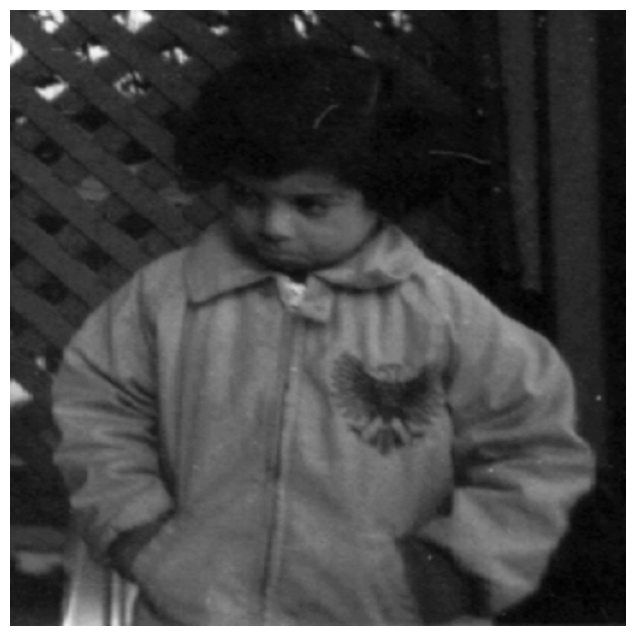

size =  (512, 512)
max  =  224
min  =  74


In [4]:
X0 = imread('pout.png',0)
plt.figure(figsize=(8,8))
plt.axis('off')
plt.imshow(X0,cmap='gray')
plt.show()
howis(X0)

# Otra forma

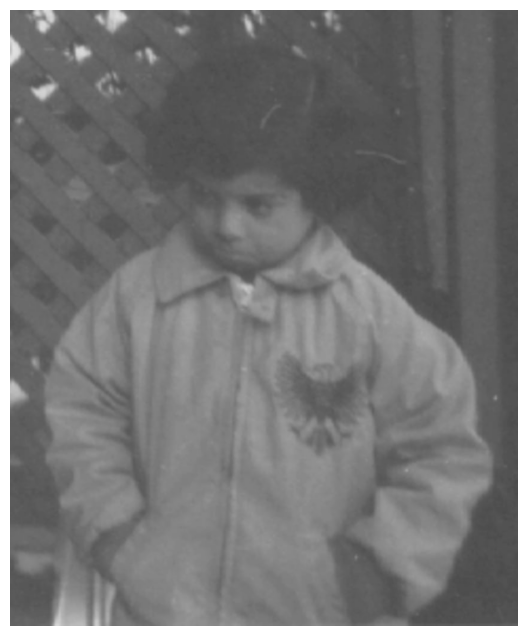

[107 107 107]
[107 107 107]
[107 107 107]
[107 107 107]
[107 107 107]
[107 107 107]
[107 107 107]
[107 107 107]
[107 107 107]
[107 107 107]
[107 107 107]
[106 106 106]
[106 106 106]
[105 105 105]
[105 105 105]
[105 105 105]
[104 104 104]
[104 104 104]
[104 104 104]
[105 105 105]
[106 106 106]
[107 107 107]
[107 107 107]
[108 108 108]
[108 108 108]
[108 108 108]
[108 108 108]
[108 108 108]
[108 108 108]
[108 108 108]
[108 108 108]
[108 108 108]
[106 106 106]
[106 106 106]
[105 105 105]
[106 106 106]
[108 108 108]
[111 111 111]
[114 114 114]
[116 116 116]
[123 123 123]
[132 132 132]
[146 146 146]
[160 160 160]
[171 171 171]
[183 183 183]
[194 194 194]
[201 201 201]
[208 208 208]
[208 208 208]
[209 209 209]
[209 209 209]
[208 208 208]
[207 207 207]
[205 205 205]
[204 204 204]
[200 200 200]
[200 200 200]
[198 198 198]
[197 197 197]
[195 195 195]
[193 193 193]
[192 192 192]
[191 191 191]
[190 190 190]
[190 190 190]
[190 190 190]
[190 190 190]
[191 191 191]
[193 193 193]
[194 194 194]
[195 1

In [16]:
X0 = imread('pout.jpg')
plt.figure(figsize=(8,8))
plt.axis('off')
plt.imshow(X0)
plt.show()
otraforma(X0)


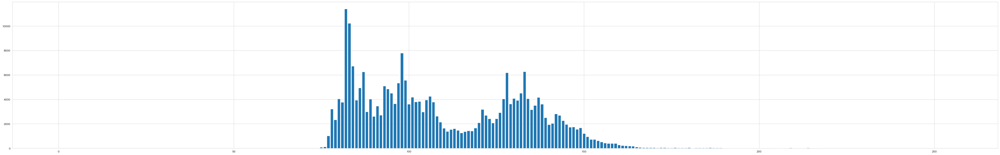

In [5]:
imhist(X0)

size =  (512, 512)
max  =  255
min  =  0


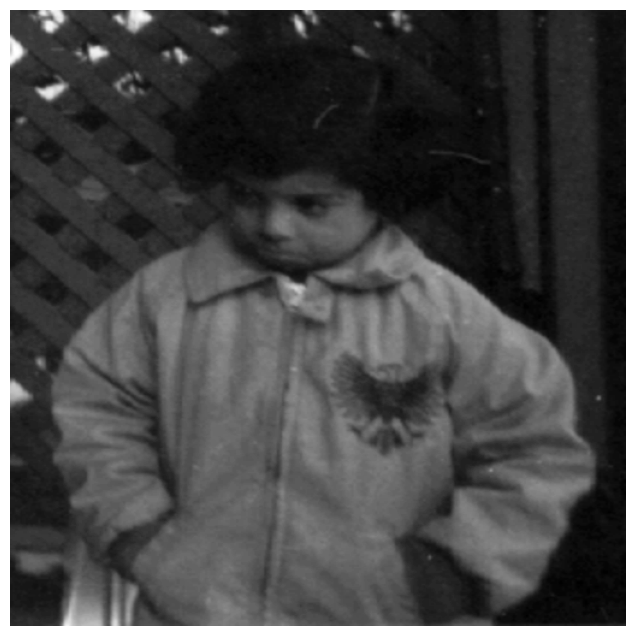

In [6]:
X1 = X0.copy()
X1 = 255 * ((X1 - X1.min()) / (X1.max() - X1.min()))
X1 = X1.astype(np.uint8)
howis(X1)
plt.figure(figsize=(8,8))
plt.axis('off')
plt.imshow(X1,cmap='gray')

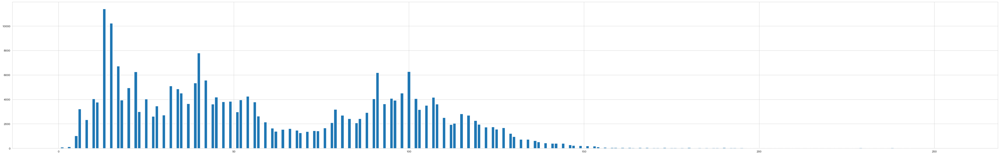

In [7]:
imhist(X1)

size =  (512, 512)
max  =  255
min  =  0


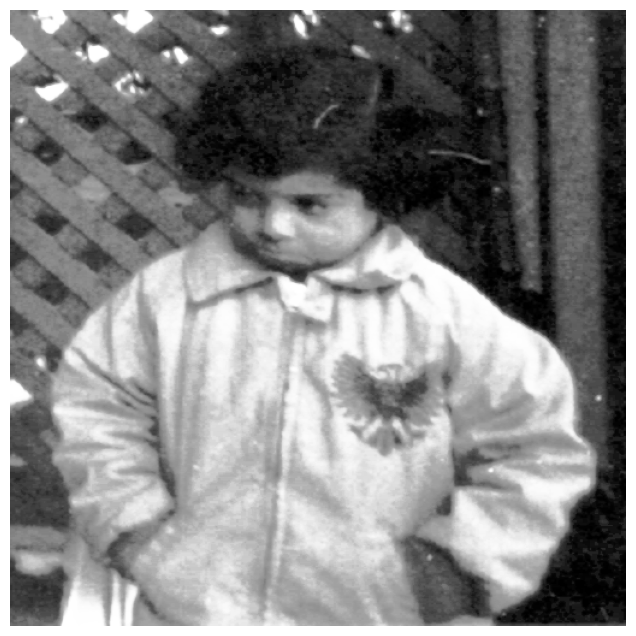

In [8]:
X2 = hist_forceuni(X0)
howis(X2)
plt.figure(figsize=(8,8))
plt.axis('off')
plt.imshow(X2,cmap='gray')

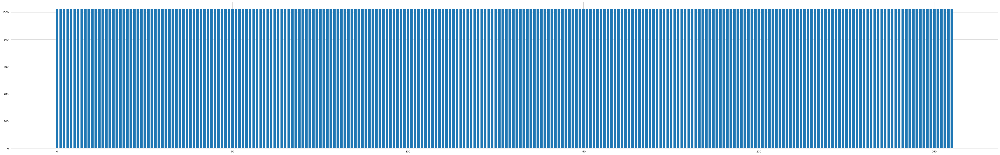

In [9]:
imhist(X2)

Una buena solución con la que me encontré en el libro Python: Real World Machine Learning es convertir nuestra imagen al espacio de color YUV, ecualizar el canal Y, y finalmente convertir el resultado a RGB. Así que la primera cosa que hacemos es convertir nuestra imagen a YUV. Esto puede hacerse usando el método cvtColor(), el cuál convierte la imagen de un espacio de color a otro, como sigue:

In [17]:
img = cv2.imread('pout.jpg')
img_to_yuv = cv2.cvtColor(img,cv2.COLOR_BGR2YUV)
img_to_yuv[:,:,0] = cv2.equalizeHist(img_to_yuv[:,:,0])
hist_equalization_result = cv2.cvtColor(img_to_yuv, cv2.COLOR_YUV2BGR)
cv2.imwrite('result.jpg',hist_equalization_result)

True

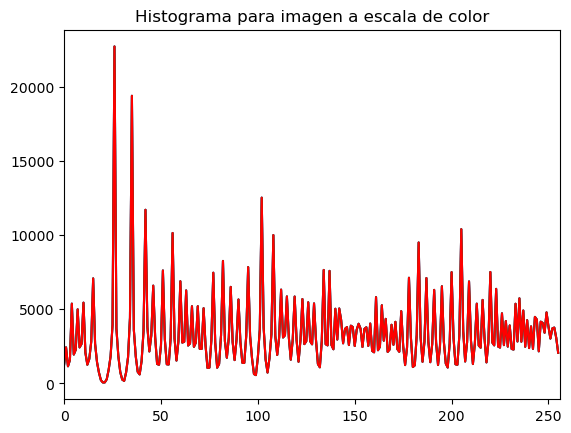

In [21]:
img_1 = cv2.imread('result.jpg')
color = ('b','g','r')
for channel,col in enumerate(color):
    histr = cv2.calcHist([img_1],[channel],None,[256],[0,256])
    plt.plot(histr,color = col)
    plt.xlim([0,256])
plt.title('Histograma para imagen a escala de color')
plt.show()

Ver implementación [from skratch](https://medium.com/hackernoon/histogram-equalization-in-python-from-scratch-ebb9c8aa3f23)

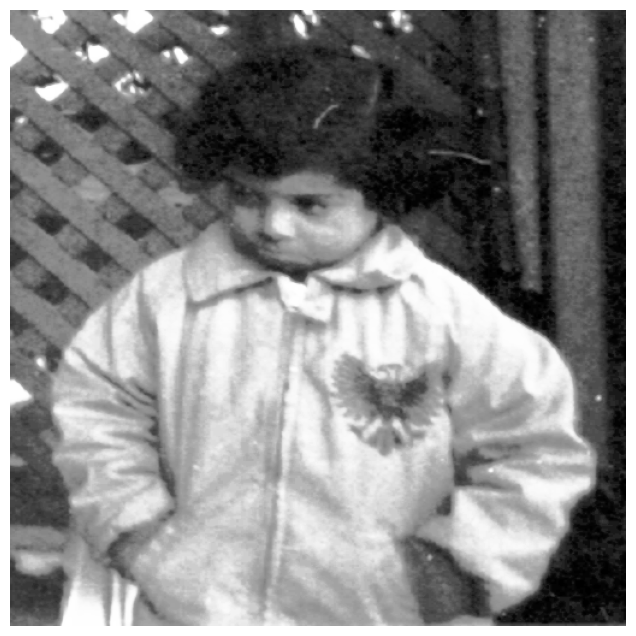

In [10]:
from cv2 import equalizeHist 
X3 = equalizeHist(X0)
plt.figure(figsize=(8,8))
plt.axis('off')
plt.imshow(X3,cmap='gray')

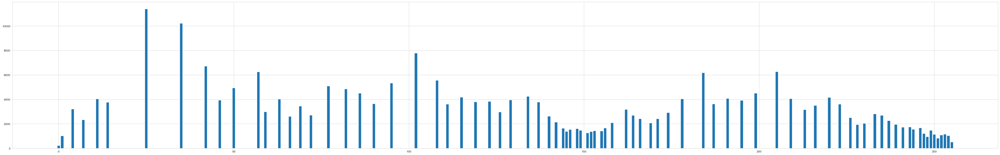

In [11]:
imhist(X3)

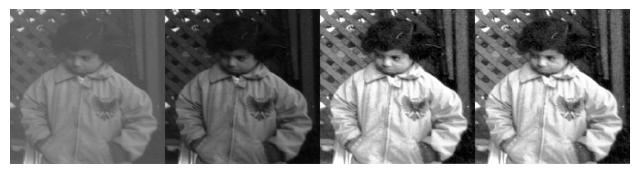

In [12]:
Y = np.hstack((X0,X1,X2,X3))
plt.figure(figsize=(8,8))
plt.axis('off')
plt.imshow(Y,cmap='gray')
# original, expanded, uni-forced, not-uniforced